In [49]:
import cv2
import numpy as np
from matplotlib import pyplot as plt
plt.rcParams['figure.figsize'] = [15, 10]

img = cv2.imread('data/image.jpeg')
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

# Інверсія

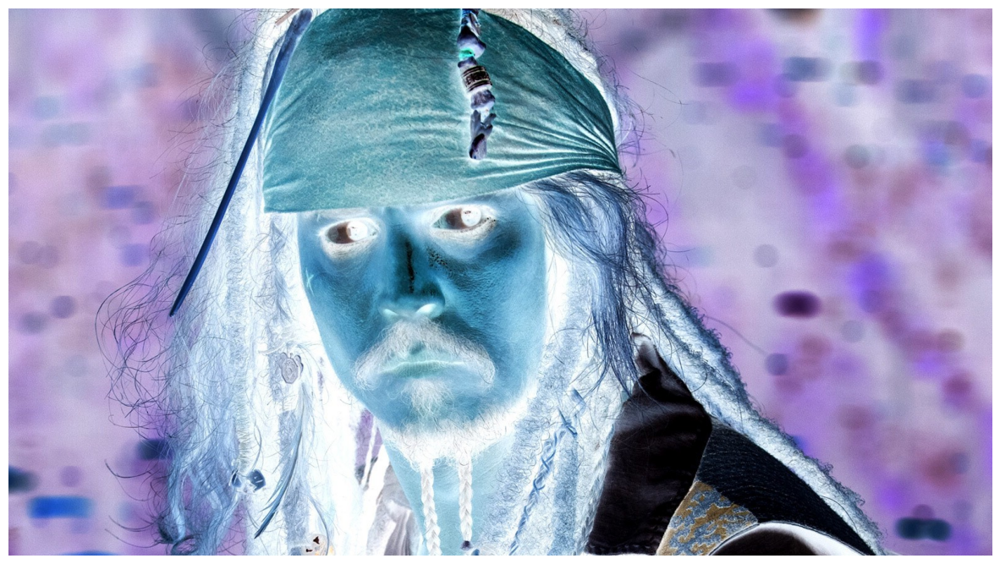

In [50]:
inv_img = 255 - img
plt.axis('off')
plt.imshow(inv_img)

# Додавання константи

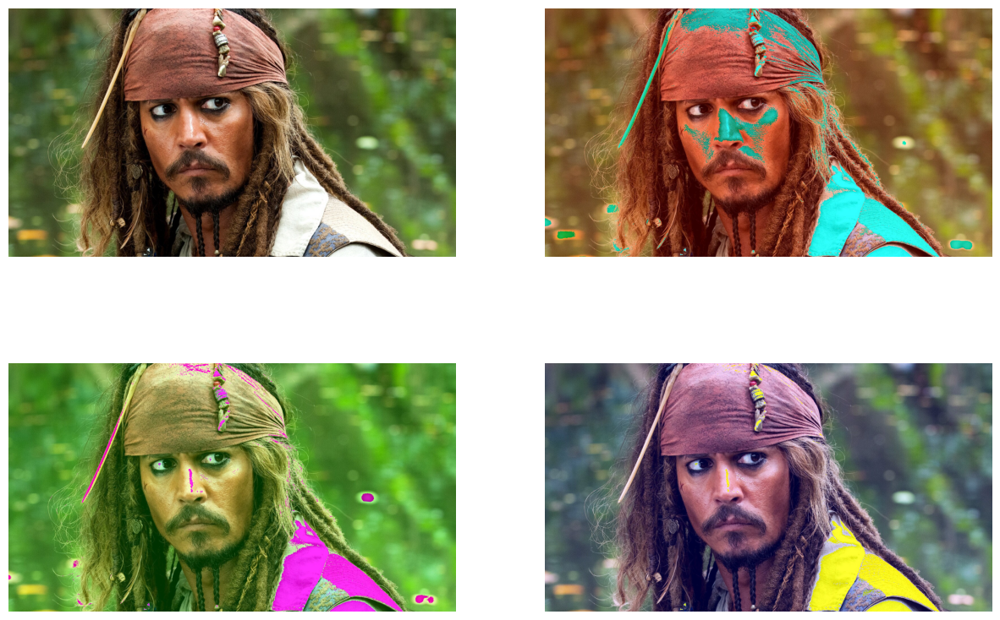

In [51]:
r, g, b = cv2.split(img)

c1_img = cv2.merge((r + 50, g, b))
c2_img = cv2.merge((r, g + 50, b))
c3_img = cv2.merge((r, g, b + 50))

plt.subplot(2, 2, 1)
plt.imshow(img)
plt.axis('off')
plt.subplot(2, 2, 2)
plt.imshow(c1_img)
plt.axis('off')
plt.subplot(2, 2, 3)
plt.imshow(c2_img)
plt.axis('off')
plt.subplot(2, 2, 4)
plt.imshow(c3_img)
plt.axis('off')
plt.show()

# Окремі канали

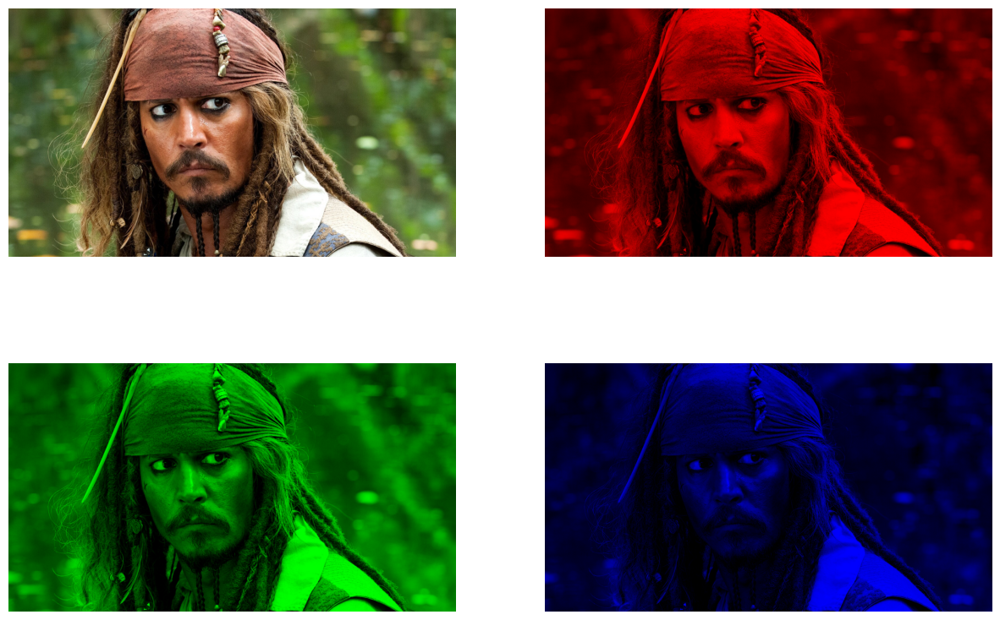

In [52]:
z = np.zeros_like(r)

r_img = cv2.merge((r, z, z))
g_img = cv2.merge((z, g, z))
b_img = cv2.merge((z, z, b))

plt.subplot(2, 2, 1)
plt.imshow(img)
plt.axis('off')
plt.subplot(2, 2, 2)
plt.imshow(r_img)
plt.axis('off')
plt.subplot(2, 2, 3)
plt.imshow(g_img)
plt.axis('off')
plt.subplot(2, 2, 4)
plt.imshow(b_img)
plt.axis('off')
plt.show()

# Злиття

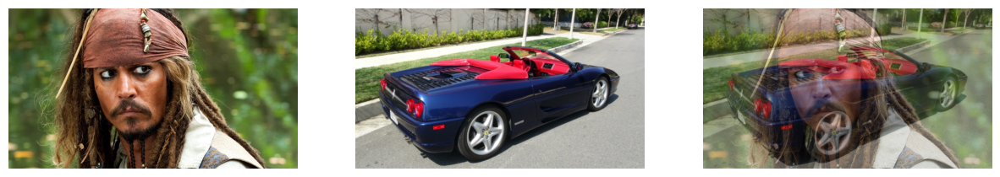

In [53]:
img2 = cv2.imread('data/car.jpg')
img2 = cv2.cvtColor(img2, cv2.COLOR_BGR2RGB)

merged = img * 0.5 + img2 * 0.5
merged = np.clip(merged, 0, 255).astype(np.uint8)

plt.subplot(1, 3, 1)
plt.imshow(img)
plt.axis('off')
plt.subplot(1, 3, 2)
plt.imshow(img2)
plt.axis('off')
plt.subplot(1, 3, 3)
plt.imshow(merged)
plt.axis('off')
plt.show()

# Фільтри

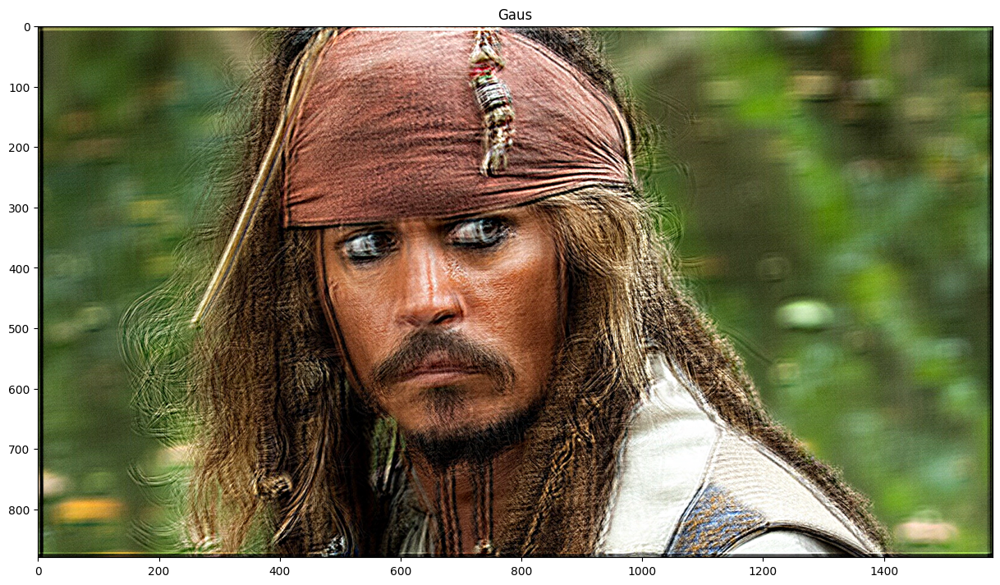

In [36]:
def convolve(image, kernel):
    i_h, i_w = image.shape
    k_h, k_w = kernel.shape
    pad_h = k_h // 2
    pad_w = k_w // 2
    padded = np.pad(image, ((pad_h, pad_h), (pad_w, pad_w)), mode='constant')
    output = np.zeros_like(image, dtype=np.float32)
    for y in range(i_h):
        for x in range(i_w):
            region = padded[y:y+k_h, x:x+k_w]
            output[y, x] = np.sum(region * kernel)
    return output

gaus = np.random.normal(size=(20, 20))
gaus /= np.sum(gaus)
channels = []
for c in range(3):
    convolved = convolve(img[:, :, c], gaus)
    channels.append(convolved)
img_gaus = np.stack(channels, axis=2)
img_gaus = np.clip(img_gaus, 0, 255).astype(np.uint8)
plt.title("Gaus")
plt.imshow(img_gaus)
plt.axis('off')

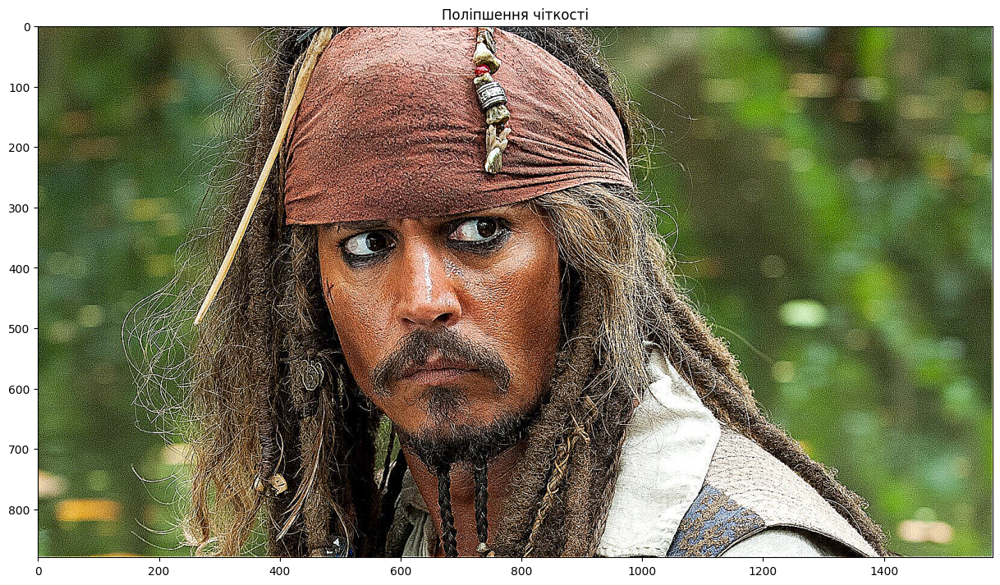

In [35]:
clear = np.array([[-1, -1, -1], [-1, 9, -1], [-1, -1, -1]])
channels = []
for c in range(3):
    convolved = convolve(img[:, :, c], clear)
    channels.append(convolved)
img_clear = np.stack(channels, axis=2)
img_clear = np.clip(img_clear, 0, 255).astype(np.uint8)
plt.title("Поліпшення чіткості")
plt.imshow(img_clear)
plt.axis('off')

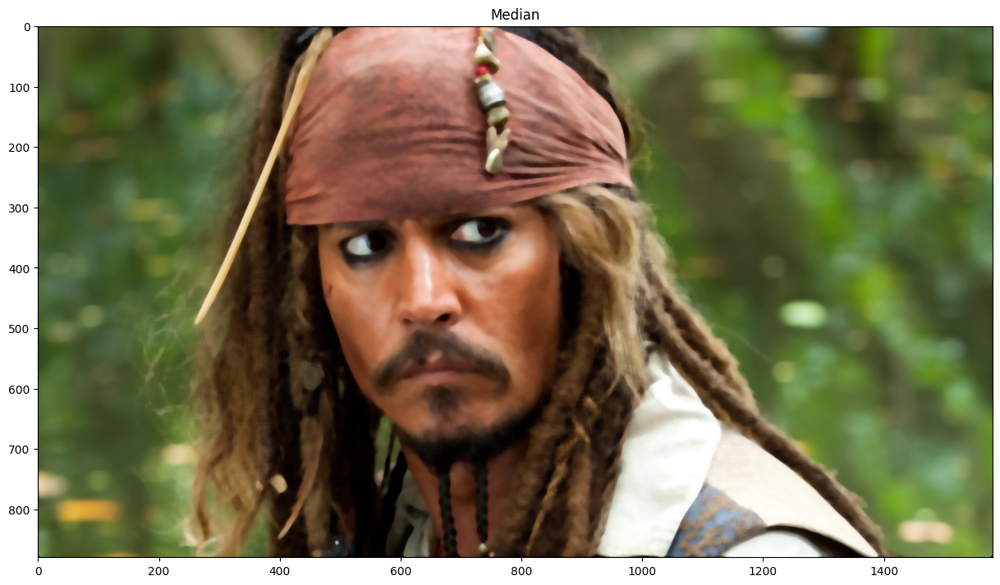

In [37]:
def median(image, kernel_size = (3, 3)):
    i_h, i_w = image.shape
    k_h, k_w = kernel_size
    pad_h = k_h // 2
    pad_w = k_w // 2
    padded = np.pad(image, ((pad_h, pad_h), (pad_w, pad_w)), mode='constant')
    output = np.zeros_like(image, dtype=np.float32)
    for y in range(i_h):
        for x in range(i_w):
            median_ = np.median(np.sort(padded[y:y+k_h, x:x+k_w].flatten()))
            output[y, x] = median_
    return output

channels = []
for c in range(3):
    convolved = median(img[:, :, c], (10, 10))
    channels.append(convolved)
img_median = np.stack(channels, axis=2)
img_median = np.clip(img_median, 0, 255).astype(np.uint8)
plt.title("Median")
plt.imshow(img_median)
plt.axis('off')

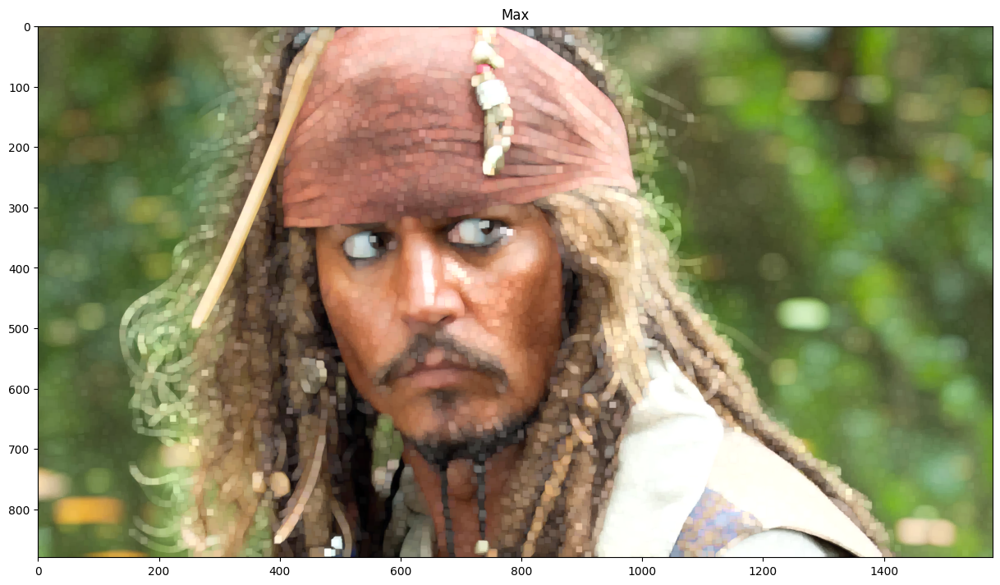

In [38]:
def maxi(image, kernel_size = (3, 3)):
    i_h, i_w = image.shape
    k_h, k_w = kernel_size
    pad_h = k_h // 2
    pad_w = k_w // 2
    padded = np.pad(image, ((pad_h, pad_h), (pad_w, pad_w)), mode='constant')
    output = np.zeros_like(image, dtype=np.float32)
    for y in range(i_h):
        for x in range(i_w):
            maxi_ = np.max(padded[y:y+k_h, x:x+k_w])
            output[y, x] = maxi_
    return output

channels = []
for c in range(3):
    convolved = maxi(img[:, :, c], (10, 10))
    channels.append(convolved)
img_maxi = np.stack(channels, axis=2)
img_maxi = np.clip(img_maxi, 0, 255).astype(np.uint8)
plt.title("Max")
plt.imshow(img_maxi)
plt.axis('off')

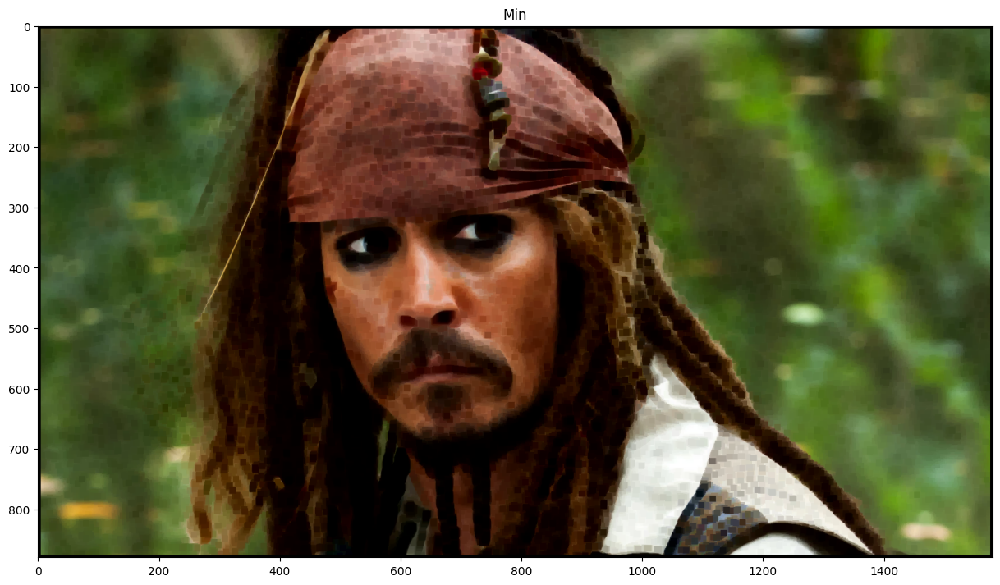

In [39]:
def mini(image, kernel_size = (3, 3)):
    i_h, i_w = image.shape
    k_h, k_w = kernel_size
    pad_h = k_h // 2
    pad_w = k_w // 2
    padded = np.pad(image, ((pad_h, pad_h), (pad_w, pad_w)), mode='constant')
    output = np.zeros_like(image, dtype=np.float32)
    for y in range(i_h):
        for x in range(i_w):
            mini_ = np.min(padded[y:y+k_h, x:x+k_w])
            output[y, x] = mini_
    return output

channels = []
for c in range(3):
    convolved = mini(img[:, :, c], (10, 10))
    channels.append(convolved)
img_mini = np.stack(channels, axis=2)
img_mini = np.clip(img_mini, 0, 255).astype(np.uint8)
plt.title("Min")
plt.imshow(img_mini)
plt.axis('off')

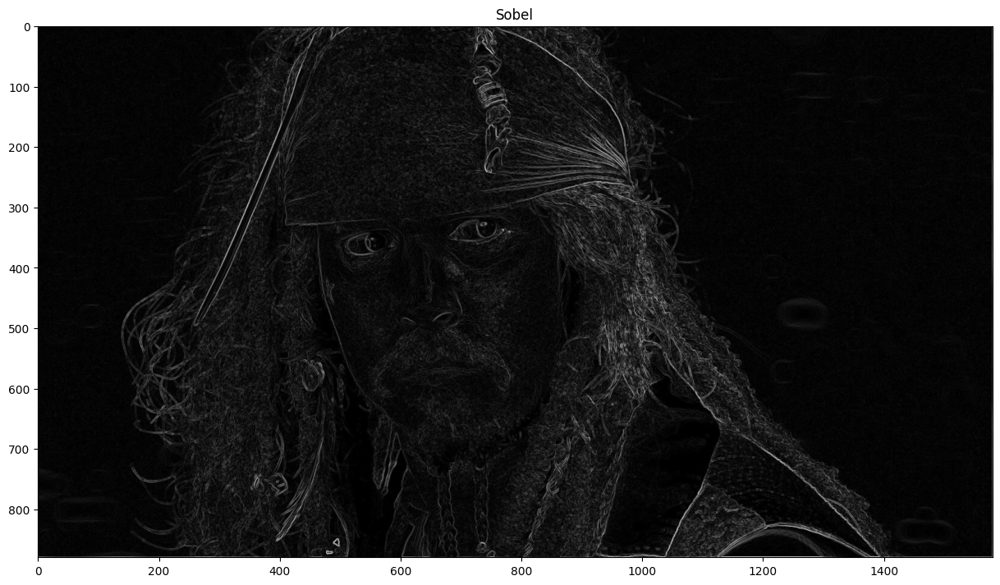

In [40]:
img_g = cv2.cvtColor(cv2.cvtColor(img, cv2.COLOR_RGB2BGR), cv2.COLOR_BGR2GRAY)

Kx = np.array([[-1, 0, 1],
               [-2, 0, 2],
               [-1, 0, 1]])

Ky = np.array([[-1, -2, -1],
               [ 0,  0,  0],
               [ 1,  2,  1]])

Gx = convolve(img_g, Kx)
Gy = convolve(img_g, Ky)

img_sobel = np.sqrt(Gx**2 + Gy**2)
img_sobel = (img_sobel / img_sobel.max() * 255).astype(np.uint8)
plt.title("Sobel")
plt.imshow(img_sobel, cmap='grey')
plt.axis('off')

# Watermark

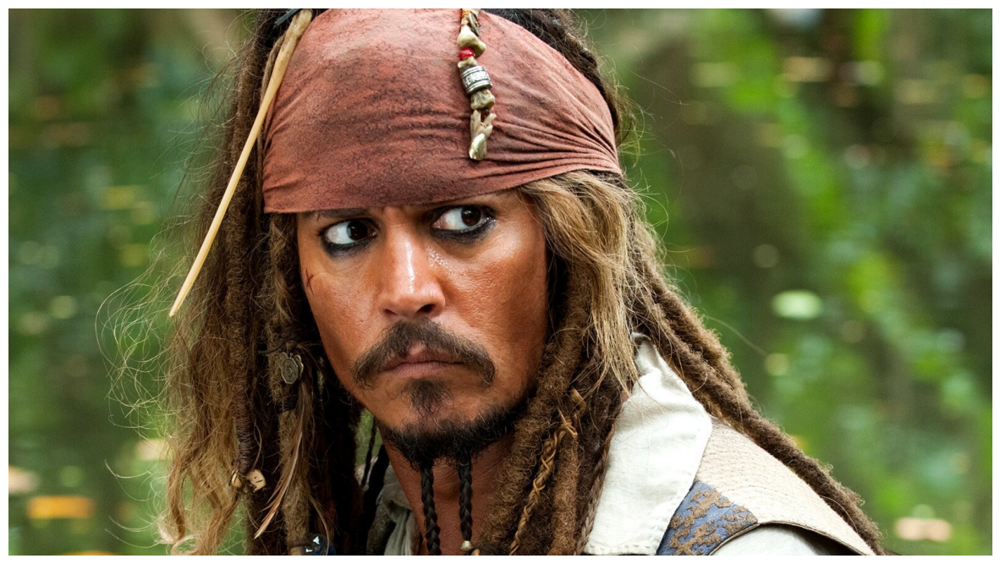

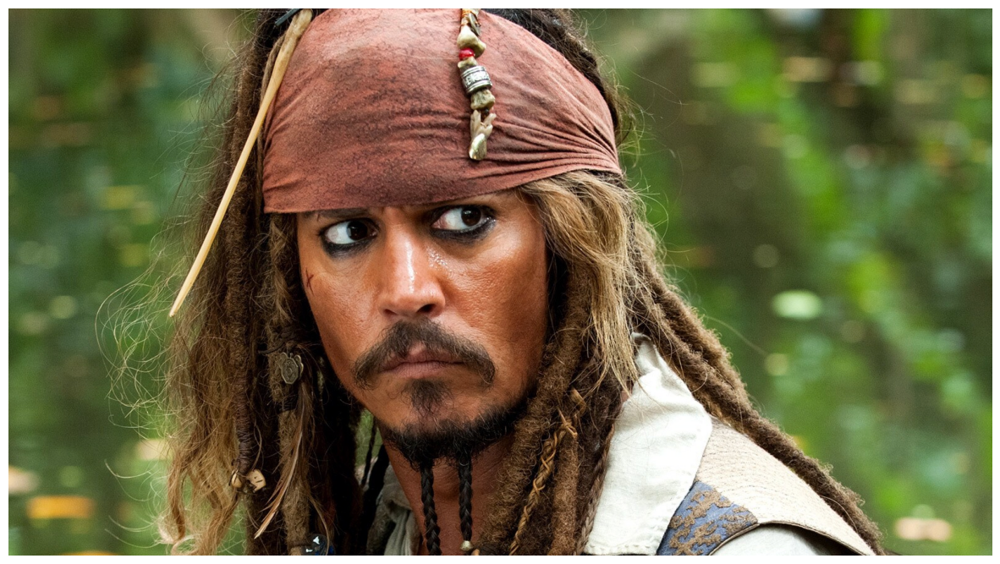

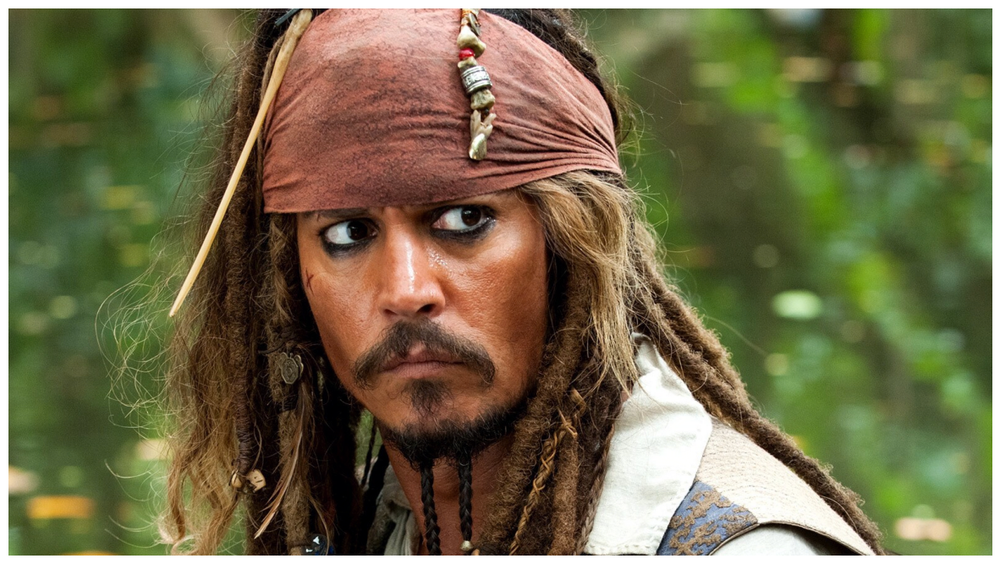

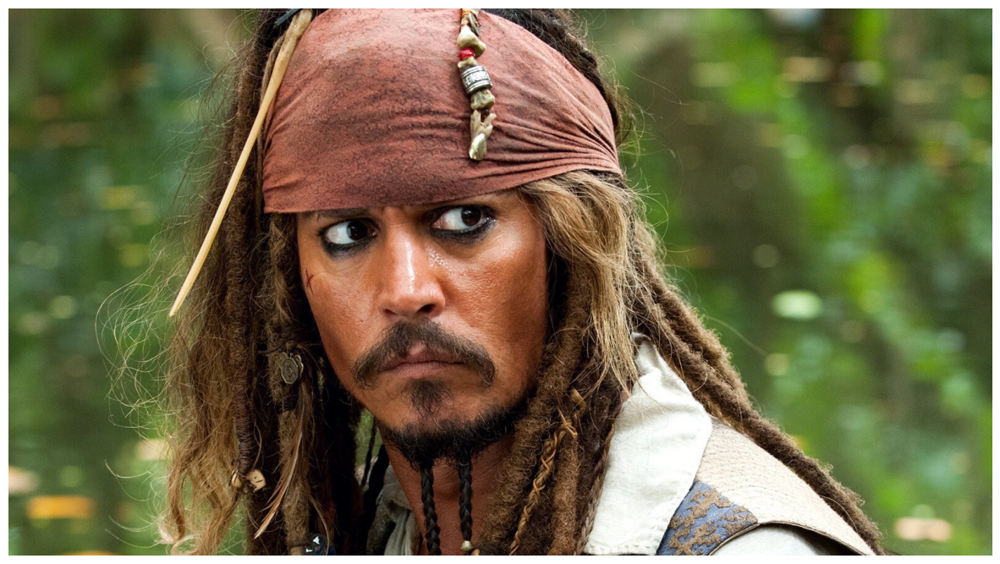

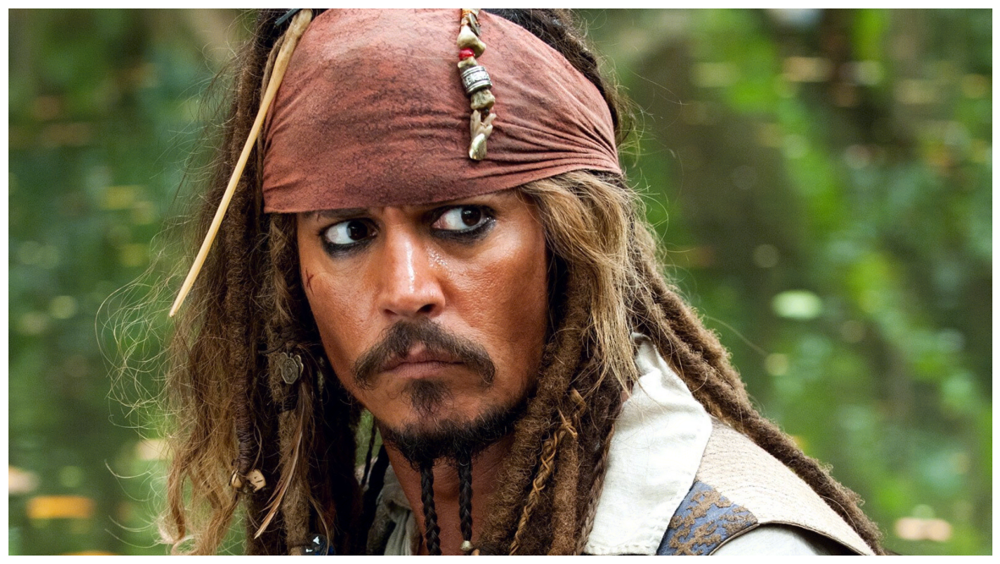

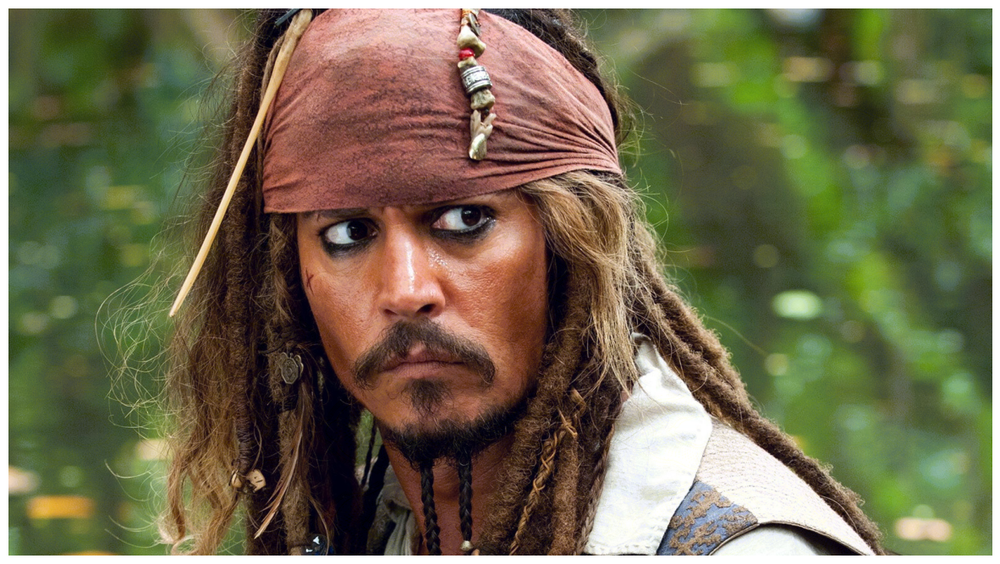

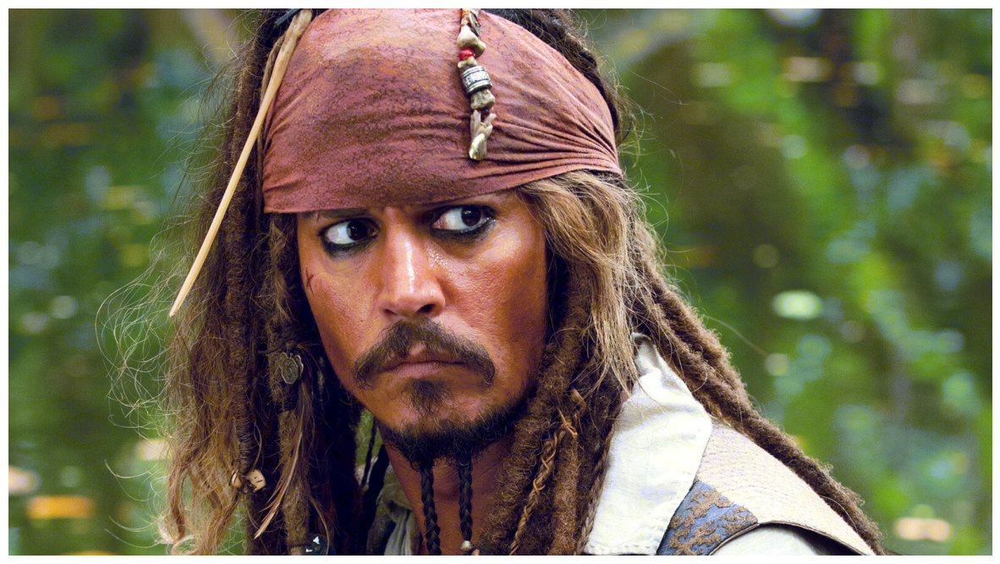

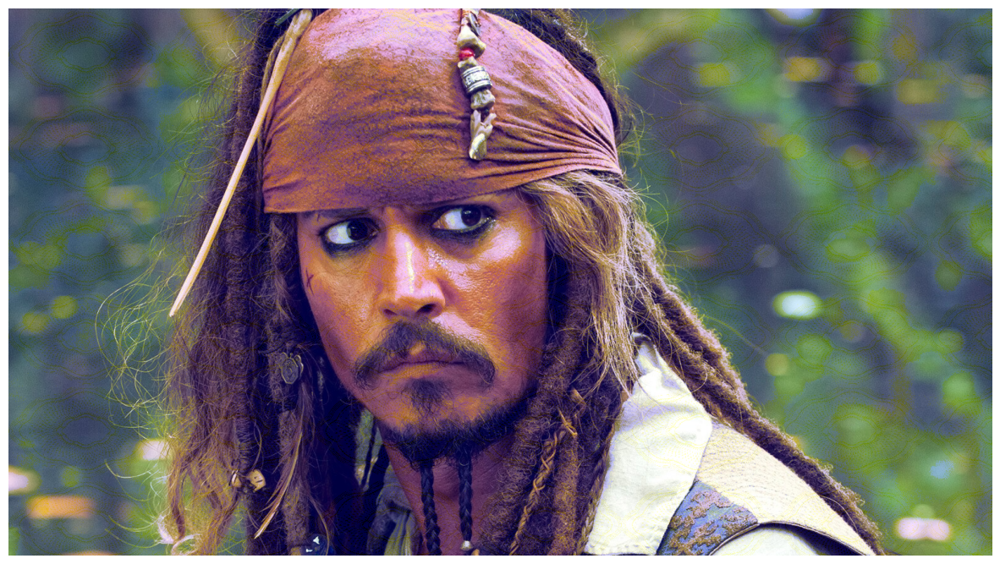

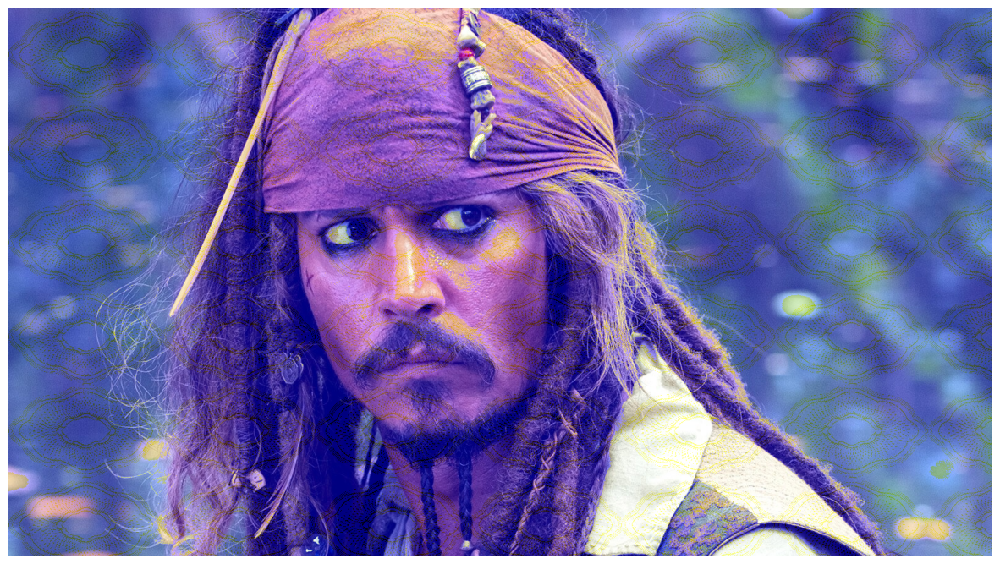

In [48]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

wm = cv2.imread('data/WM.png')

wm_blue = wm[:, :, 2]

tile_rows = int(np.ceil(img.shape[0] / wm.shape[0]))
tile_cols = int(np.ceil(img.shape[1] / wm.shape[1]))
wm_tiled = np.tile(wm_blue, (tile_rows, tile_cols))
wm_tiled = wm_tiled[:img.shape[0], :img.shape[1]]

wm_bite = np.zeros(wm_tiled.shape, dtype=int)
for i in range(wm_tiled.shape[0]):
    for j in range(wm_tiled.shape[1]):
        wm_bite[i, j] = int('{0:08b}'.format(wm_tiled[i, j])[0])

blue_chanel = img[:, :, 2]

binary_1 = np.zeros(blue_chanel.shape, dtype=int)
binary_2 = np.zeros(blue_chanel.shape, dtype=int)
binary_3 = np.zeros(blue_chanel.shape, dtype=int)
binary_4 = np.zeros(blue_chanel.shape, dtype=int)
binary_5 = np.zeros(blue_chanel.shape, dtype=int)
binary_6 = np.zeros(blue_chanel.shape, dtype=int)
binary_7 = np.zeros(blue_chanel.shape, dtype=int)
binary_8 = np.zeros(blue_chanel.shape, dtype=int)

for i in range(blue_chanel.shape[0]):
    for j in range(blue_chanel.shape[1]):
        number = '{0:08b}'.format(blue_chanel[i, j])
        binary_1[i, j] = int(number[7])
        binary_2[i, j] = int(number[6])
        binary_3[i, j] = int(number[5])
        binary_4[i, j] = int(number[4])
        binary_5[i, j] = int(number[3])
        binary_6[i, j] = int(number[2])
        binary_7[i, j] = int(number[1])
        binary_8[i, j] = int(number[0])

result_1 = np.zeros(blue_chanel.shape)
result_2 = np.zeros(blue_chanel.shape)
result_3 = np.zeros(blue_chanel.shape)
result_4 = np.zeros(blue_chanel.shape)
result_5 = np.zeros(blue_chanel.shape)
result_6 = np.zeros(blue_chanel.shape)
result_7 = np.zeros(blue_chanel.shape)
result_8 = np.zeros(blue_chanel.shape)

for i in range(blue_chanel.shape[0]):
    for j in range(blue_chanel.shape[1]):
        number_1 = (str(wm_bite[i, j]) + str(binary_2[i, j]) + str(binary_3[i, j]) + str(binary_4[i, j]) +
                    str(binary_5[i, j]) + str(binary_6[i, j]) + str(binary_7[i, j]) + str(binary_8[i, j]))[::-1]
        result_1[i, j] = int(number_1, 2)

        number_2 = (str(binary_1[i, j]) + str(wm_bite[i, j]) + str(binary_3[i, j]) + str(binary_4[i, j]) +
                    str(binary_5[i, j]) + str(binary_6[i, j]) + str(binary_7[i, j]) + str(binary_8[i, j]))[::-1]
        result_2[i, j] = int(number_2, 2)

        number_3 = (str(binary_1[i, j]) + str(binary_2[i, j]) + str(wm_bite[i, j]) + str(binary_4[i, j]) +
                    str(binary_5[i, j]) + str(binary_6[i, j]) + str(binary_7[i, j]) + str(binary_8[i, j]))[::-1]
        result_3[i, j] = int(number_3, 2)

        number_4 = (str(binary_1[i, j]) + str(binary_2[i, j]) + str(binary_3[i, j]) + str(wm_bite[i, j]) +
                    str(binary_5[i, j]) + str(binary_6[i, j]) + str(binary_7[i, j]) + str(binary_8[i, j]))[::-1]
        result_4[i, j] = int(number_4, 2)

        number_5 = (str(binary_1[i, j]) + str(binary_2[i, j]) + str(binary_3[i, j]) + str(binary_4[i, j]) +
                    str(wm_bite[i, j]) + str(binary_6[i, j]) + str(binary_7[i, j]) + str(binary_8[i, j]))[::-1]
        result_5[i, j] = int(number_5, 2)

        number_6 = (str(binary_1[i, j]) + str(binary_2[i, j]) + str(binary_3[i, j]) + str(binary_4[i, j]) +
                    str(binary_5[i, j]) + str(wm_bite[i, j]) + str(binary_7[i, j]) + str(binary_8[i, j]))[::-1]
        result_6[i, j] = int(number_6, 2)

        number_7 = (str(binary_1[i, j]) + str(binary_2[i, j]) + str(binary_3[i, j]) + str(binary_4[i, j]) +
                    str(binary_5[i, j]) + str(binary_6[i, j]) + str(wm_bite[i, j]) + str(binary_8[i, j]))[::-1]
        result_7[i, j] = int(number_7, 2)

        number_8 = (str(binary_1[i, j]) + str(binary_2[i, j]) + str(binary_3[i, j]) + str(binary_4[i, j]) +
                    str(binary_5[i, j]) + str(binary_6[i, j]) + str(binary_7[i, j]) + str(wm_bite[i, j]))[::-1]
        result_8[i, j] = int(number_8, 2)

image_wm_1 = img.copy()
image_wm_2 = img.copy()
image_wm_3 = img.copy()
image_wm_4 = img.copy()
image_wm_5 = img.copy()
image_wm_6 = img.copy()
image_wm_7 = img.copy()
image_wm_8 = img.copy()

image_wm_1[:, :, 2] = result_1
image_wm_2[:, :, 2] = result_2
image_wm_3[:, :, 2] = result_3
image_wm_4[:, :, 2] = result_4
image_wm_5[:, :, 2] = result_5
image_wm_6[:, :, 2] = result_6
image_wm_7[:, :, 2] = result_7
image_wm_8[:, :, 2] = result_8

images_to_show = [
    img, image_wm_1, image_wm_2, image_wm_3, image_wm_4, image_wm_5, image_wm_6, image_wm_7, image_wm_8
]

for i in images_to_show:
    plt.imshow(i)
    plt.axis('off')
    plt.show()